# Import Modules

In [85]:
import json
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import statistics as stats
import geopandas as gpd
from shapely.geometry import Point
import folium
import branca.colormap as cm
import numpy as np
import ast
from pandas.tseries.offsets import DateOffset
import geemap
import ee

# Load and Join the Datasets

Sentinel-2 data was collected across two laptop over multiple days, hence why all the files were separate from one another. They required joining before any data cleaning or exploration could be done.

## File Names

In [ ]:
# Sentinel-2 Band Paths
SENTINEL_PATH_ORIGINAL = "data/modelling/baseline_datasets/20250609_sentinel_bands_30_days.txt"
SENTINEL_PATH_EXTRA = "data/modelling/baseline_datasets/20250630_sentinel_bands.txt"
SENTINEL_PATH_DAYOF = "data/modelling/baseline_datasets/250630_sentinel_dayof_survey_bands.txt"

# Sentinel-2 Cloud Probability Paths
SENTINEL_CLOUDS_ORIGINAL = "data/modelling/baseline_datasets/20250612_cloudprob_only_array_30_days.txt"
SENTINEL_CLOUDS_EXTRA = "data/modelling/baseline_datasets/20250704_cloudprob_only_array_extra.txt"
SENTINEL_CLOUDS_DAYOF = "data/modelling/baseline_datasets/20250701_cloudprob_only_array_dayof.txt"

SOIL_PATH = "data/modelling/baseline_datasets/250627_lucas_2018_cleaned.csv"

## Load the Files

In [3]:
# Function to read text files as json
def read_txt_as_df(filepath):
    rows = []
    with open(filepath, 'r+') as f:
        for line in f:
            try: 
                data = json.loads(line)
                if isinstance(data, dict):
                    rows.append(data)
            except json.JSONDecodeError:
                continue

    # Convert to a dataframe
    df = pd.DataFrame(rows)
    return df

In [ ]:
# Sentinel Surface Reflectance
sentinel_older = read_txt_as_df(SENTINEL_PATH_ORIGINAL)
sentinel_extra = read_txt_as_df(SENTINEL_PATH_EXTRA)
sentinel_dayof = read_txt_as_df(SENTINEL_PATH_DAYOF)

# Sentinel Cloud Cover
sencloud_older = read_txt_as_df(SENTINEL_CLOUDS_ORIGINAL)
sencloud_extra = read_txt_as_df(SENTINEL_CLOUDS_EXTRA)
sencloud_dayof = read_txt_as_df(SENTINEL_CLOUDS_DAYOF)

In [70]:
# Read Soil
soil = pd.read_csv(SOIL_PATH)

## Merge the Dataframes

### Sentinel Surface Reflection

In [5]:
# Columns to join on
cols = ['point_id', 'survey_date', 'image_date', 'days_diff']

In [6]:
# Concatenate all sentinel Dataframes
sentinel_all = pd.concat([sentinel_older, sentinel_extra, sentinel_dayof])

# Correct datetime format
sentinel_all['survey_date'] = pd.to_datetime(sentinel_all['survey_date'])
sentinel_all['image_date'] = pd.to_datetime(sentinel_all['image_date'])

# Calculate days between survey and image date
sentinel_all['days_diff'] = (sentinel_all['survey_date'] - sentinel_all['image_date']).dt.days

print(f"Length of joined dataframe: {len(sentinel_all)}")

# Drop images taken on the same date for each point ID
sentinel_all = sentinel_all.drop_duplicates(subset=['point_id', 'image_date'], keep='last')
print(f"Length of de-duplicated dataframe: {len(sentinel_all)}")

Length of joined dataframe: 214520
Length of de-duplicated dataframe: 176936


### Cloud Probability

In [7]:
# Concatenate all sentinel Dataframes
sentinel_cloud = pd.concat([sencloud_older, sencloud_extra, sencloud_dayof])

# Correct datetime format
sentinel_cloud['survey_date'] = pd.to_datetime(sentinel_cloud['survey_date'])
sentinel_cloud['image_date'] = pd.to_datetime(sentinel_cloud['image_date'])

# Calculate days between survey and image date
sentinel_cloud['days_diff'] = (sentinel_cloud['survey_date'] - sentinel_cloud['image_date']).dt.days

print(f"Length of joined dataframe: {len(sentinel_cloud)}")

# Drop images taken on the same date for each point ID
sentinel_cloud = sentinel_cloud.drop_duplicates(subset=['point_id', 'image_date'], keep='last')
print(f"Length of de-duplicated dataframe: {len(sentinel_cloud)}")

Length of joined dataframe: 175259
Length of de-duplicated dataframe: 164385


### Join Surface Reflectance and Cloud Probability

In [8]:
# Join based on point ID and Survey Date
sentinel_merged = sentinel_all.merge(sentinel_cloud, on=cols, how='inner')
print(f"Length of the joined dataframe: {len(sentinel_merged)}")
print(f"Number of Point IDs in the merged dataframe: {sentinel_merged['point_id'].nunique()}")

Length of the joined dataframe: 161933
Number of Point IDs in the merged dataframe: 15877


In [9]:
# Rename cloud probability bands so they work in the next loop
rename_dict = {'cloud_probability': 'cloud_center',
               'cloud_patch_array': 'cloud_array'}
sentinel_merged = sentinel_merged.rename(columns=rename_dict)

### Load the Extended Dataset from the Last 365 Days

In [10]:
# 30-62 day dataframe
FILENAME_30_62 = "data/modelling/365day_datasets/raw/20250730_sentinel_bands_and_cloud_30-62days.txt"

# CSV file for 30-365 days
FILENAME_CSV_30_365 = "data/modelling/365day_datasets/raw/20250730_sentinel_bands_and_cloud_30-365days_62-365mix.csv"

# Remaining samples txt files first and second half 
FILENAME_62_365_FIRST = "data/modelling/365day_datasets/raw/20250801_sentinel_bands_and_cloud_62-365days_firsthalf.txt"
FILENAME_62_365_SECOND = "data/modelling/365day_datasets/raw/20250801_sentinel_bands_and_cloud_62-365days_secondhalf.txt"

In [ ]:
# Read all the raw data files
df_3062 = read_txt_as_df(FILENAME_30_62)
df_30365 = pd.read_csv(FILENAME_CSV_30_365)
df_62365_1 = read_txt_as_df(FILENAME_62_365_FIRST)
df_62365_2 = read_txt_as_df(FILENAME_62_365_SECOND)

In [20]:
# Save txt files to csvs for quicker loading next time
df_3062.to_csv("data/modelling/365day_datasets/raw/20250730_sentinel_bands_and_cloud_30-62days.csv", index=False)
df_62365_1.to_csv("data/modelling/365day_datasets/raw/20250801_sentinel_bands_and_cloud_62-365days_firsthalf.csv", index=False)
df_62365_2.to_csv("data/modelling/365day_datasets/raw/20250801_sentinel_bands_and_cloud_62-365days_secondhalf.csv", index=False)

### Merge Dataframes

In [28]:
# Concatenate all sentinel Dataframes
sentinel_365 = pd.concat([df_3062, df_30365, df_62365_1, df_62365_2])

# Correct datetime format
sentinel_365['survey_date'] = pd.to_datetime(sentinel_365['survey_date'])
sentinel_365['image_date'] = pd.to_datetime(sentinel_365['image_date'])

# Calculate days between survey and image date
sentinel_365['days_diff'] = (sentinel_365['survey_date'] - sentinel_365['image_date']).dt.days

print(f"Length of joined dataframe: {len(sentinel_365)}")

# Drop images taken on the same date for each point ID
sentinel_365 = sentinel_365.drop_duplicates(subset=['point_id', 'image_date'], keep='last')
print(f"Length of de-duplicated dataframe: {len(sentinel_365)}")

Length of joined dataframe: 1406312
Length of de-duplicated dataframe: 1269099


In [ ]:
# Rename cloud probability bands so they work in the next loop
rename_dict = {'cloud_probability': 'cloud_center',
               'cloud_patch_array': 'cloud_array'}
sentinel_365 = sentinel_365.rename(columns=rename_dict)
sentinel_365 = sentinel_365.drop(columns=['image_id'])

## Concatenate all

In [35]:
sen = pd.concat([sentinel_365, sentinel_merged])

print(f"Length of joined dataframe: {len(sen)}")

# Drop images taken on the same date for each point ID
sen = sen.drop_duplicates(subset=['point_id', 'image_date'], keep='last')
print(f"Length of de-duplicated dataframe: {len(sen)}")

Length of joined dataframe: 1431032
Length of de-duplicated dataframe: 1404272


## Save to CSV file

In [ ]:
print(f"Length of dataframe: {len(sen)}")
sen = sen.dropna()

In [ ]:
# Save as CSV
sen.to_csv("data/modelling/365day_datasets/processed/20250803_sentinel2_365days_array.csv", index=False)

In [4]:
# Load again - saves loading separately and joining again if it needs cleaning differently
df = pd.read_csv("./data/modelling/365day_datasets/processed/20250803_sentinel2_365days_array.csv")
sen = df.copy()

# Process Bands: Calculate mean of array

In [5]:
# List of bands
bands = ['AOT', 'B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12', 'WVP', 'cloud']

# Compute the mean for each array column
for band in bands:
    array_col = f"{band}_array"
    mean_col = f"{band}_mean"
    
    def calc_mean(array_str):
        try:
            # Convert string to actual list
            array = ast.literal_eval(array_str)
            
            # Flatten and remove None/NaN
            flat = [val for row in array for val in row if val is not None and not np.isnan(val)]
            return np.mean(flat) if flat else None
        except (ValueError, SyntaxError, TypeError):
            return None
    
    sen[mean_col] = sen[array_col].apply(calc_mean)
    sen[f"{band}_diff"] = sen[mean_col] - sen[f"{band}_center"]

In [57]:
# Drop rows with Null values
sen = sen.dropna()

# Save a copy - checkpoint
df = sen.copy()

In [7]:
## Save as CSV and create a checkpoint
checkpoint1 = df.copy()
SENTINEL_CSV_PROCESSED = "../data/modelling/365day_datasets/processed/20250803_sentinel2_365days_mean.csv"
df.to_csv(SENTINEL_CSV_PROCESSED, index=False)

## Evaluate the Difference Between Array Mean and Centre Values

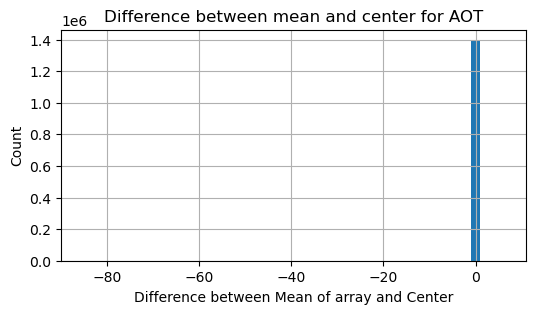

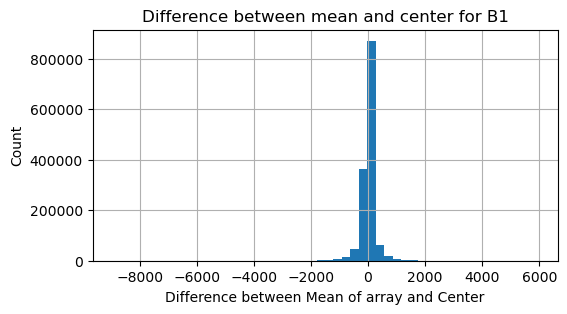

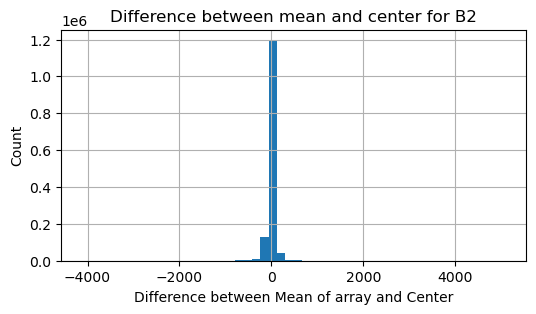

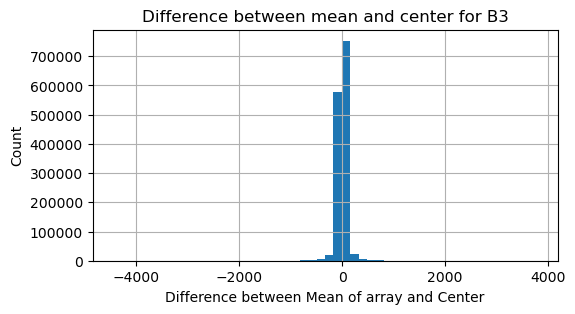

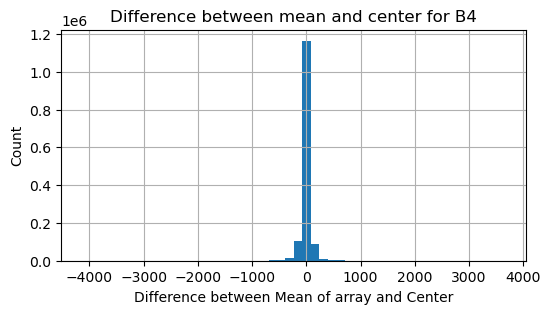

...

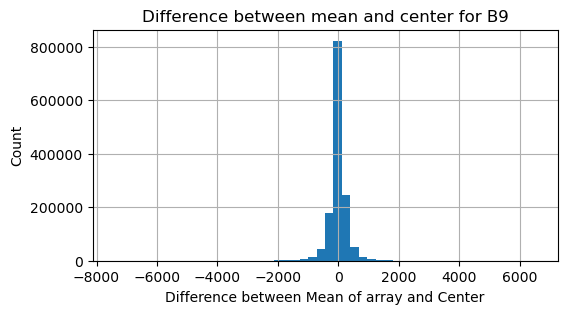

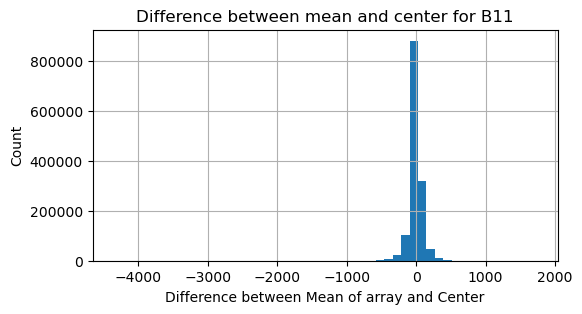

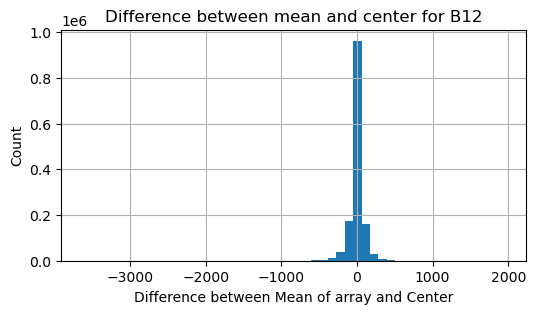

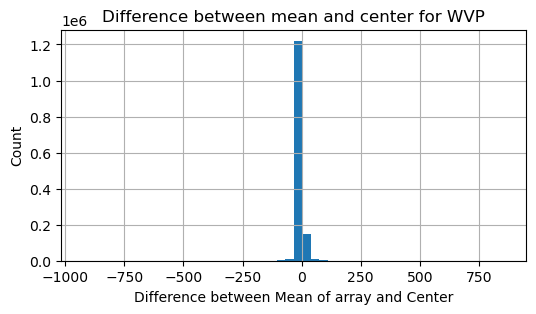

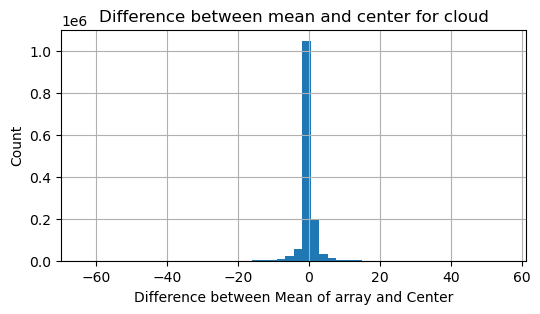

In [58]:
# Plot the difference between mean and center
for band in bands:
    df[f"{band}_diff"].hist(bins=50, figsize=(6,3))
    plt.title(f"Difference between mean and center for {band}")
    plt.xlabel("Difference between Mean of array and Center")
    plt.ylabel("Count")
    plt.show()

## Number of Images per Point ID

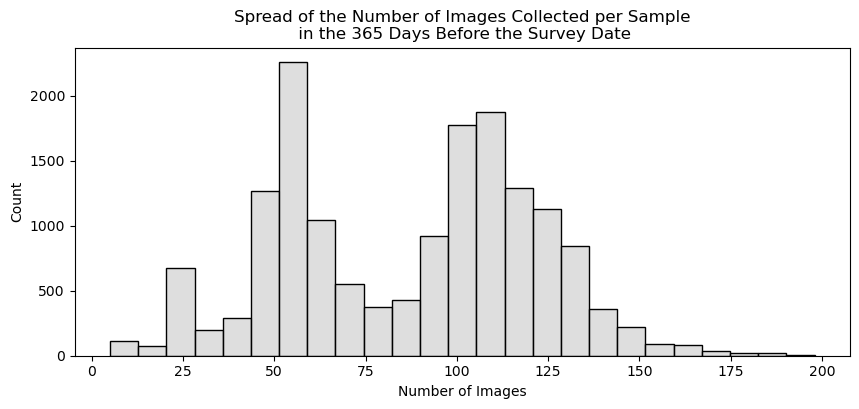

In [59]:
# Find out how many images there are for each point ID
summary = df.groupby(['point_id']).agg(
                total_images=('image_date', 'count'),
                null_count_probs=('cloud_center', lambda x: x.isnull().sum()),
                null_scl=('SCL_center', lambda x: x.isnull().sum())
            ).reset_index()

plt.figure(figsize=(10,4))
sns.histplot(summary['total_images'], bins=25, color='lightgrey')
plt.xlabel("Number of Images")
plt.title("Spread of the Number of Images Collected per Sample\n in the 365 Days Before the Survey Date")
plt.savefig('../graphs/sentinel/number_of_images_per_sample.png', dpi=300)
plt.show()

Number of cloud free sentinel images: 3875
Total number of images: 1394102
Number of points with cloud free images: 2049


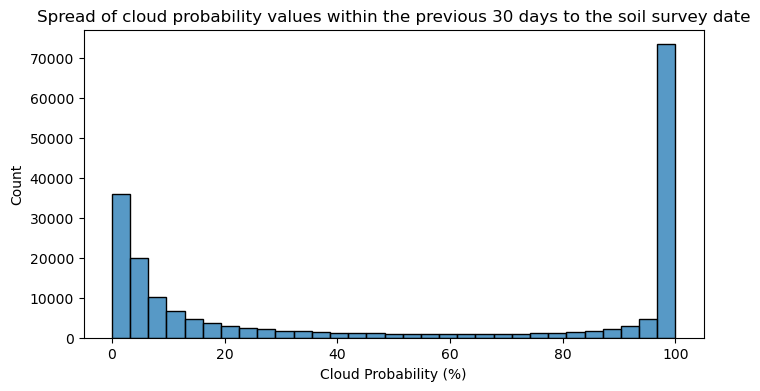

In [60]:
# Points with no cloud
print(f"Number of cloud free sentinel images: {len(df[df['cloud_mean'] == 0])}")
print(f"Total number of images: {len(df)}")
print(f"Number of points with cloud free images: {df[df['cloud_mean'] == 0]['point_id'].nunique()}")

# Within the last 30 days - histogram of the spread of cloud probability
last30 = df[df['days_diff'] <= 31]
plt.figure(figsize=(8,4))
plt.title("Spread of cloud probability values within the previous 30 days to the soil survey date")
sns.histplot(last30['cloud_mean'])
plt.xlabel("Cloud Probability (%)")
plt.show()

In [61]:
# Find out why some have over 4 images
summary[summary['total_images']>150].sort_values(by='total_images', ascending=False).head()

,point_id,total_images,null_count_probs,null_scl
8172,44963922,198,0,0
13883,52263990,192,0,0
11120,48445012,190,0,0
13849,52223990,190,0,0
9211,46223850,188,0,0


In [62]:
# Preview one of the Points with 8 images
df[df['point_id']==48585066].image_date.nunique()

174

In [63]:
# Drop duplicates based on point id, survey date and image_date
df = df.drop_duplicates(subset=['point_id', 'survey_date', 'image_date'])

## Null Analysis

## Points where images could not be found

In [64]:
null_point_df = df[df['image_date'].isnull()]
print(f"Number of points without images: {null_point_df['point_id'].nunique()}")

Number of points without images: 0


## Mean, Centre and Array Values

In [65]:
# Summary of mean vs. the center value
summary = []
for band in bands:
    corr = df[[f"{band}_center", f"{band}_mean"]].corr().iloc[0,1]
    std_center = df[f"{band}_center"].std()
    std_mean = df[f"{band}_mean"].std()
    summary.append({
        'band': band,
        'correlation': corr,
        'std_center': std_center,
        'std_mean': std_mean
    })

summary_df = pd.DataFrame(summary)
summary_df['pct_diff'] = (1-(summary_df['std_center'] / summary_df['std_mean'])) * 100
summary_df

,band,correlation,std_center,std_mean,pct_diff
0,AOT,0.999980,61.399306,61.398656,-0.001059
1,B1,0.998231,4192.323424,4164.000645,-0.680182
2,B2,0.999634,3880.018632,3873.955211,-0.156518
3,B3,0.999598,3536.138657,3530.070678,-0.171894
4,B4,0.999568,3438.627072,3432.064814,-0.191204
5,B5,0.998966,3387.447546,3373.815568,-0.404052
6,B6,0.998524,2957.132138,2942.026277,-0.513451
7,B7,0.998258,2806.804476,2790.435375,-0.586615
8,B8,0.999120,2840.308912,2831.198604,-0.321783
9,B8A,0.998157,2671.680364,2655.075016,-0.625419


## Difference between Mean and Centre for Band Values

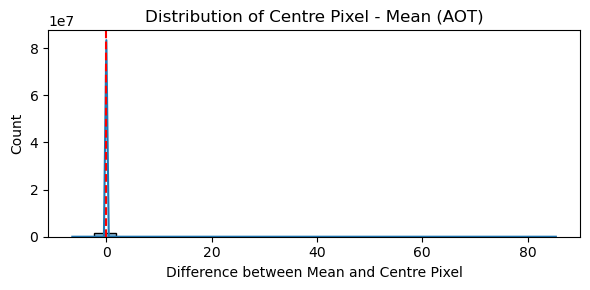

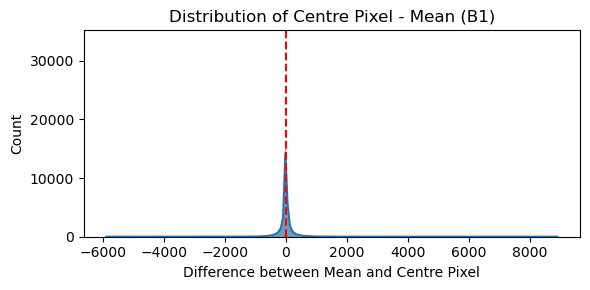

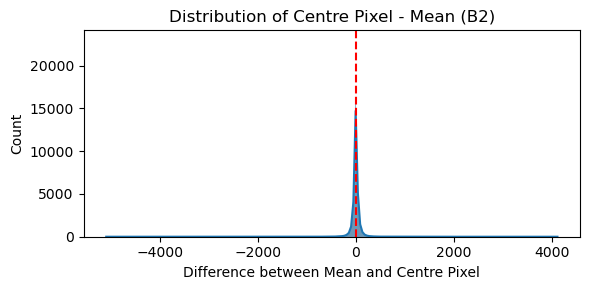

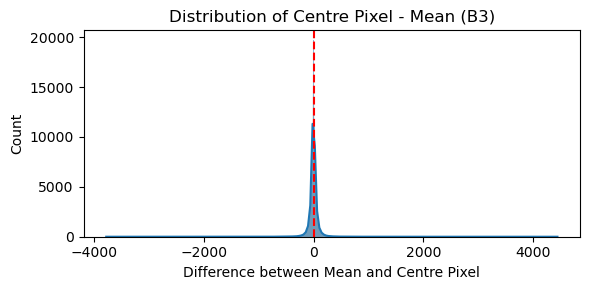

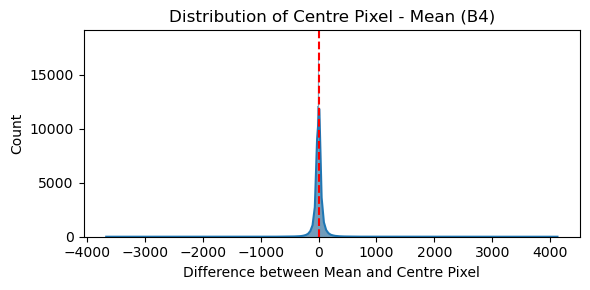

...

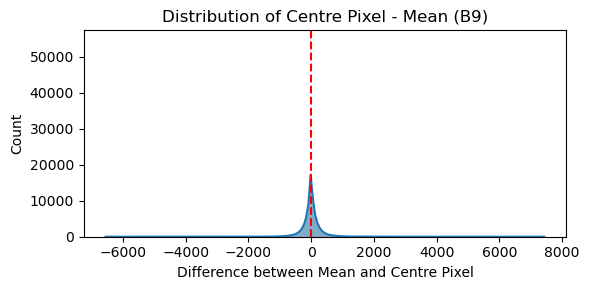

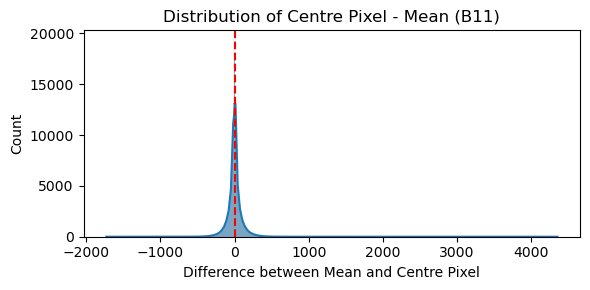

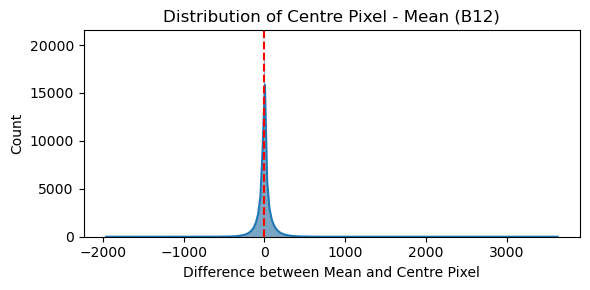

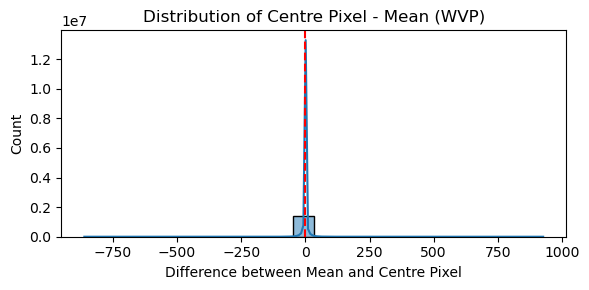

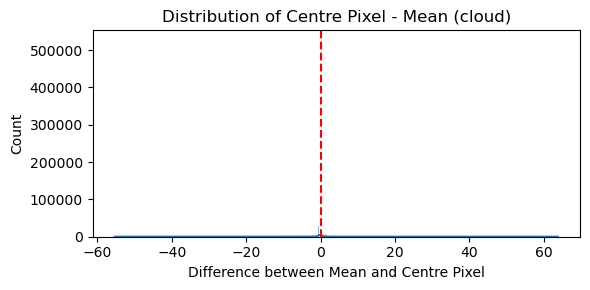

In [66]:
for band in bands:
    diff = df[f'{band}_center'] - df[f'{band}_mean']
    plt.figure(figsize=(6,3))
    sns.histplot(diff, kde=True)
    plt.axvline(0, color='red', linestyle='--')
    plt.title(f"Distribution of Centre Pixel - Mean ({band})")
    plt.xlabel("Difference between Mean and Centre Pixel")
    plt.ylabel("Count")
    plt.tight_layout()
    plt.savefig(f"../graphs/sentinel/centre_vs_mean/{band}.png", dpi=300)
    plt.show()

### Scatterplot of Pixel Array vs. Centre Cloud Probability

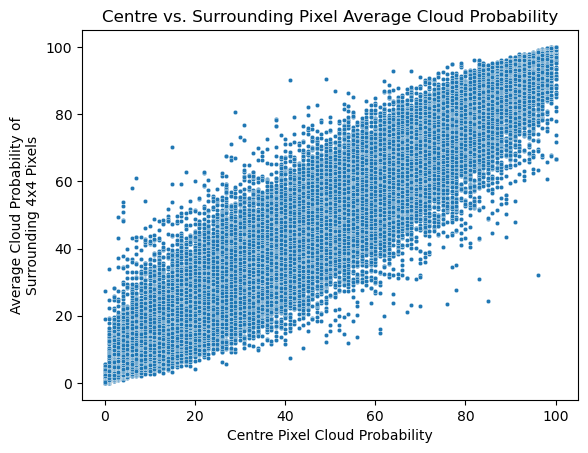

In [19]:
# CLoud Probability
plt.figure()
sns.scatterplot(data=df, x='cloud_center', y='cloud_mean', s=10)
plt.title("Centre vs. Surrounding Pixel Average Cloud Probability")
plt.xlabel("Centre Pixel Cloud Probability")
plt.ylabel("Average Cloud Probability of\nSurrounding 4x4 Pixels")
plt.show()

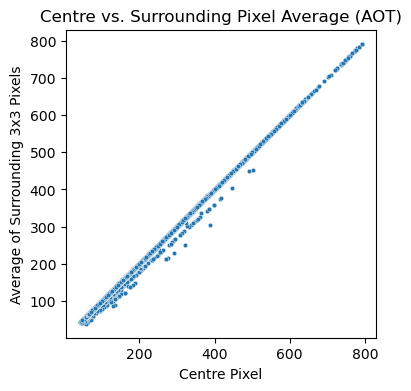

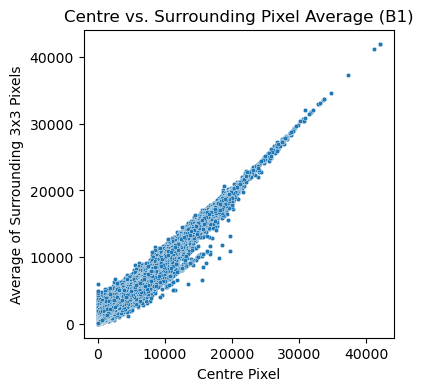

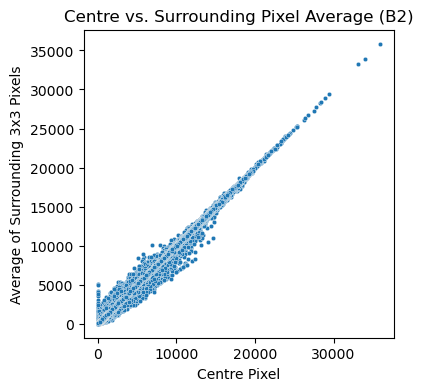

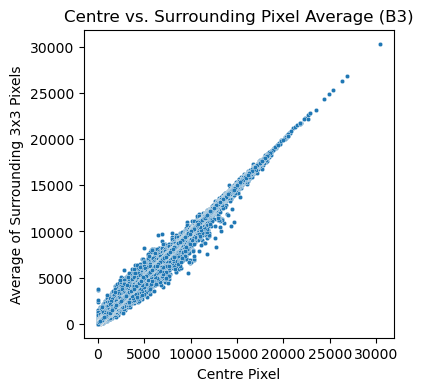

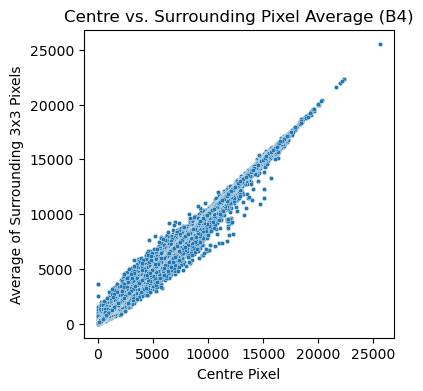

...

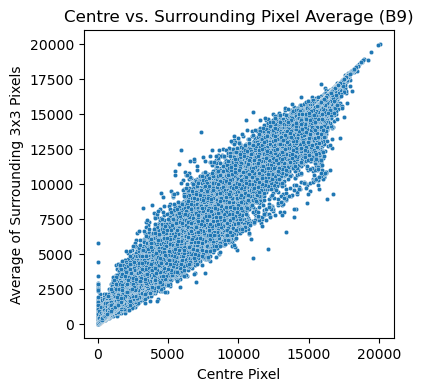

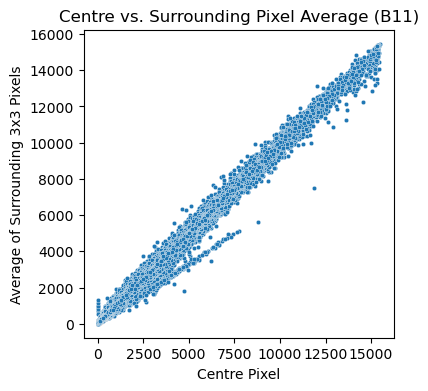

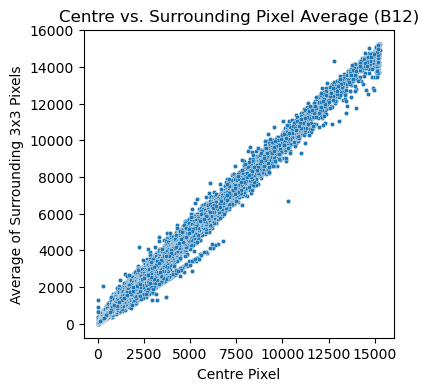

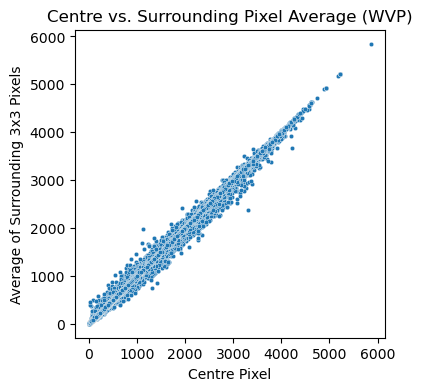

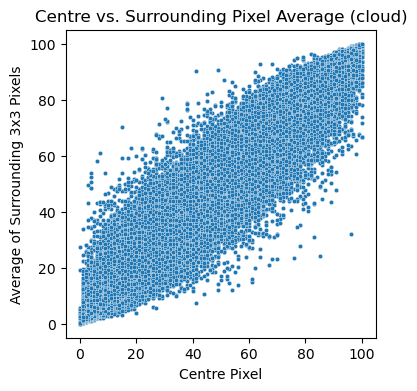

In [20]:
# For every band, plot the average of the array versus the centre value
for band in bands:
    plt.figure(figsize=(4,4))
    sns.scatterplot(data=df, x=f'{band}_center', y=f'{band}_mean', s=10)
    plt.title(f"Centre vs. Surrounding Pixel Average ({band})")
    plt.xlabel("Centre Pixel")
    plt.ylabel("Average of Surrounding 3x3 Pixels")
    plt.show()

### How many values come up for SCL in the array?

In [21]:
scl_df = pd.DataFrame()

In [22]:
scl_df['SCL_flat'] = df["SCL_array"].apply(lambda patch: [val for row in patch for val in row])
scl_df['unique_values_scl'] = scl_df['SCL_flat'].apply(lambda x: len(set(x)))
scl_df['length_array_scl'] = scl_df['SCL_flat'].apply(lambda x: len(x))

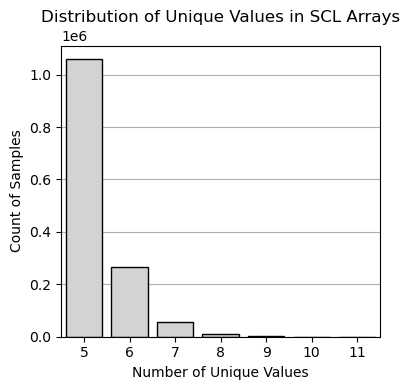

In [23]:
bar_data = scl_df['unique_values_scl'].value_counts().sort_index()

# Plot
fig, ax = plt.subplots()
fig.set_figwidth(4)
fig.set_figheight(4)
sns.barplot(x=bar_data.index.astype(str), y=bar_data.values, color='lightgrey', edgecolor='black')
plt.title("Distribution of Unique Values in SCL Arrays")
plt.xlabel("Number of Unique Values")
plt.ylabel("Count of Samples")
plt.grid(True, axis='y')  # Enable horizontal grid
ax.set_axisbelow(True)
plt.tight_layout()
plt.show()

## Select Means and Modes only

In [24]:
# Calculate the mode of SCL
df['SCL_mode'] = df['SCL_array'].apply(lambda x: stats.mode([val for row in x for val in row]))

bands_mean = [f"{band}_mean" for band in bands]
select_bands = ['point_id', 'survey_date', 'image_date', 'SCL_mode'] + bands_mean

mean_df = df[select_bands]

## Calculate Moisture Index and NDVI

In [25]:
mean_df['NDVI'] = (mean_df['B8_mean'] - mean_df['B4_mean']) / (mean_df['B8_mean'] + mean_df['B4_mean'])
mean_df['moisture_index'] = (mean_df['B8A_mean'] - mean_df['B11_mean']) / (mean_df['B8A_mean'] + mean_df['B11_mean']) 
mean_df['EVI'] = 2.5 * ((mean_df['B8_mean'] - mean_df['B4_mean']) / (mean_df['B8_mean'] + 6 * mean_df['B4_mean'] - 7.5 * mean_df['B2_mean'] + 1))
mean_df['SAVI'] = ((mean_df['B8_mean'] - mean_df['B4_mean']) / (mean_df['B8_mean'] + mean_df['B4_mean'] + 0.5)) * 1.5

/var/folders/2w/cw97zdb154l5t4cjzcg4xx8m0000gn/T/ipykernel_78476/819534138.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mean_df['NDVI'] = (mean_df['B8_mean'] - mean_df['B4_mean']) / (mean_df['B8_mean'] + mean_df['B4_mean'])
/var/folders/2w/cw97zdb154l5t4cjzcg4xx8m0000gn/T/ipykernel_78476/819534138.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mean_df['moisture_index'] = (mean_df['B8A_mean'] - mean_df['B11_mean']) / (mean_df['B8A_mean'] + mean_df['B11_mean'])
/var/folders/2w/cw97zdb154l5t4cjzcg4

## Save as CSV

In [26]:
checkpoint1 = mean_df.copy()

In [50]:
SENTINEL_CSV_PROCESSED = "data/modelling/365day_datasets/processed/20250803_sentinel2_365days_mean.csv"

In [51]:
# Save sentinel as CSV
mean_df.to_csv(SENTINEL_CSV_PROCESSED, index=False)

In [45]:
len(mean_df)

1394102

In [27]:
df = mean_df.copy()

# Load CSV again - Additional Data Exploration

In [3]:
df = pd.read_csv(SENTINEL_CSV_PROCESSED)

In [4]:
df['survey_date'] = pd.to_datetime(df['survey_date'])
df['image_date'] = pd.to_datetime(df['image_date'])

df['days_diff'] = (df['survey_date'] - df['image_date']).dt.days

In [5]:
len(df)

161805

# Exploration

## Cloud Cover across all images

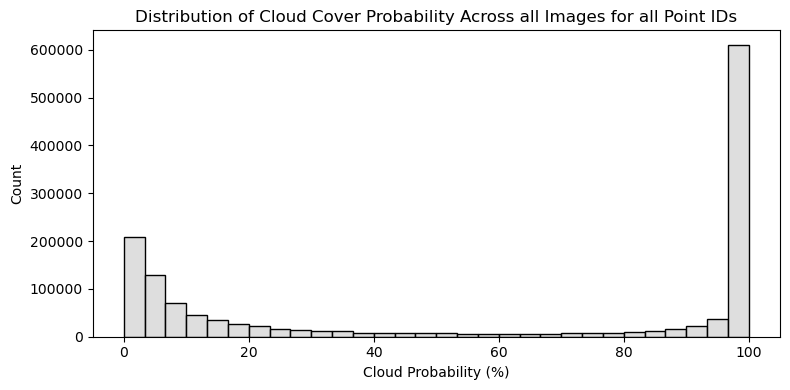

In [29]:
plt.figure(figsize=(8, 4))
sns.histplot(df['cloud_mean'], bins=30, color='lightgrey')
plt.xlabel('Cloud Probability (%)')
plt.title("Distribution of Cloud Cover Probability Across all Images for all Point IDs")
plt.tight_layout()
plt.savefig("../graphs/sentinel/histplot_cloudmean.png", dpi=300)
plt.show()

## Cloud Cover vs band correlation 

B1_mean     0.734688
B2_mean     0.726893
B3_mean     0.715968
B4_mean     0.705429
B5_mean     0.700319
B6_mean     0.671232
B7_mean     0.655330
B8_mean     0.650115
B9_mean     0.649341
B8A_mean    0.643038
B12_mean    0.603338
B11_mean    0.514325
Name: cloud_mean, dtype: float64


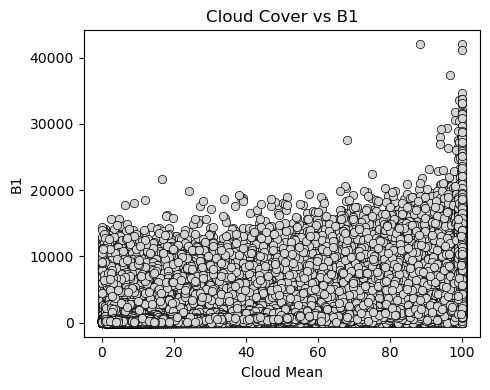

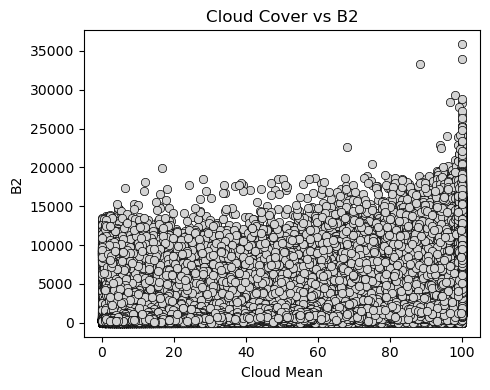

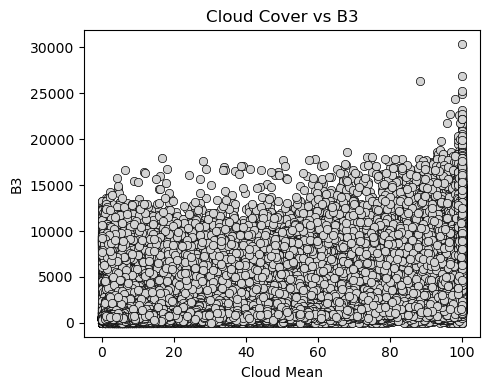

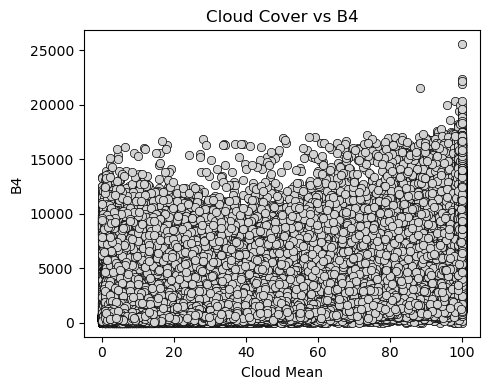

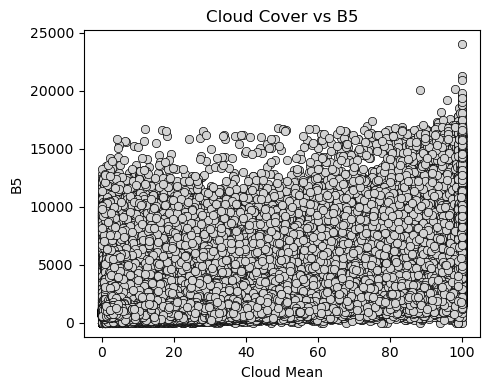

...

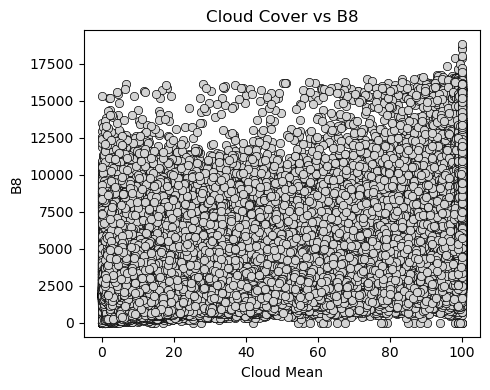

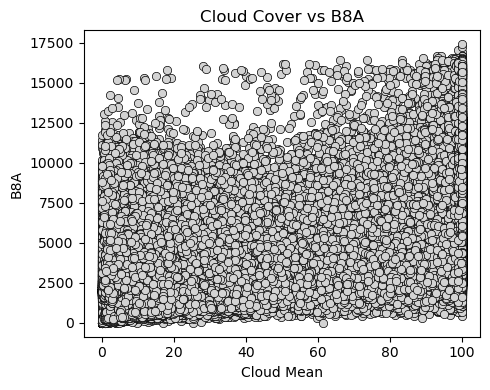

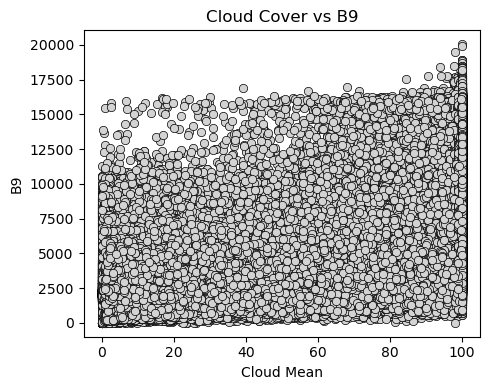

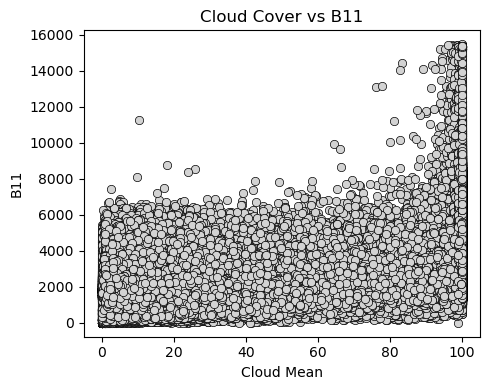

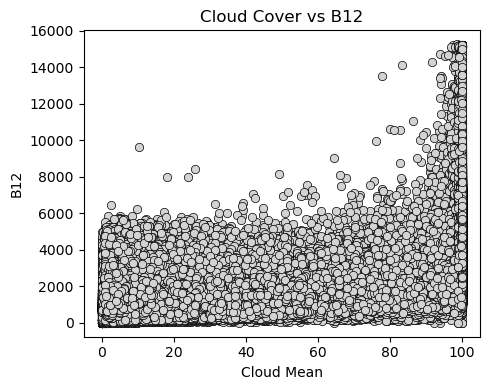

In [32]:
# Band columns
band_cols = ['B1_mean', 'B2_mean', 'B3_mean', 'B4_mean', 'B5_mean', 'B6_mean',
             'B7_mean', 'B8_mean', 'B8A_mean', 'B9_mean', 'B11_mean', 'B12_mean']

# Compute the correlation matrix
df_band_corr = df[['cloud_mean'] + band_cols]
correlations = df_band_corr.corr().loc['cloud_mean', band_cols].sort_values(ascending=False)
print(correlations)

# Plot scatter plots
for band in band_cols:
    plt.figure(figsize=(5,4))
    sns.scatterplot(data=df, x='cloud_mean', y=band,
                    color='lightgrey', edgecolor='black', linewidth=0.5)
    plt.title(f'Cloud Cover vs {band.replace("_mean", "")}')
    plt.xlabel('Cloud Mean')
    plt.ylabel(f'{band.replace("_mean", "")}')
    plt.tight_layout()
    plt.savefig(f"../graphs/sentinel/cloudmean_vs_bands_scatter/{band}.png", dpi=300)
    plt.show()

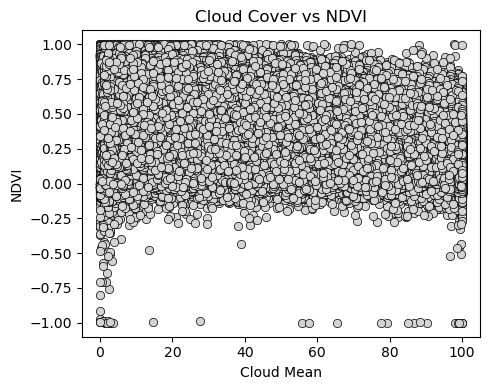

In [33]:
# Plot scatter plots
band='NDVI'
plt.figure(figsize=(5,4))
sns.scatterplot(data=df, x='cloud_mean', y=band,
                color='lightgrey', edgecolor='black', linewidth=0.5)
plt.title(f'Cloud Cover vs {band.replace("_mean", "")}')
plt.xlabel('Cloud Mean')
plt.ylabel(f'{band.replace("_mean", "")}')
plt.tight_layout()
plt.savefig(f"../graphs/sentinel/cloudmean_vs_bands_scatter/{band}.png", dpi=300)
plt.show()

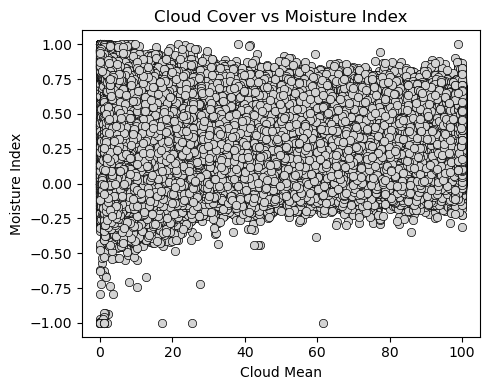

In [34]:
# Plot scatter plots
band='moisture_index'
plt.figure(figsize=(5,4))
sns.scatterplot(data=df, x='cloud_mean', y=band,
                color='lightgrey', edgecolor='black', linewidth=0.5)
plt.title(f'Cloud Cover vs Moisture Index')
plt.xlabel('Cloud Mean')
plt.ylabel(f'Moisture Index')
plt.tight_layout()
plt.savefig(f"../graphs/sentinel/cloudmean_vs_bands_scatter/{band}.png", dpi=300)
plt.show()

B1_mean     0.734688
B2_mean     0.726893
B3_mean     0.715968
B4_mean     0.705429
B5_mean     0.700319
B6_mean     0.671232
B7_mean     0.655330
B8_mean     0.650115
B9_mean     0.649341
B8A_mean    0.643038
B12_mean    0.603338
B11_mean    0.514325
Name: cloud_mean, dtype: float64


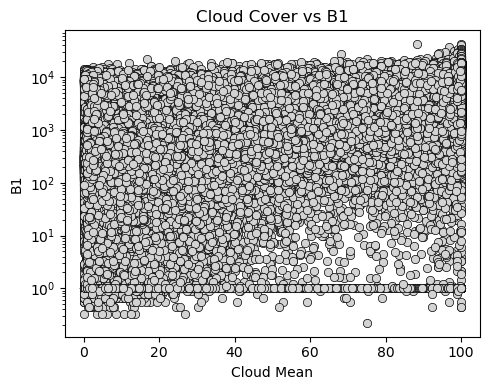

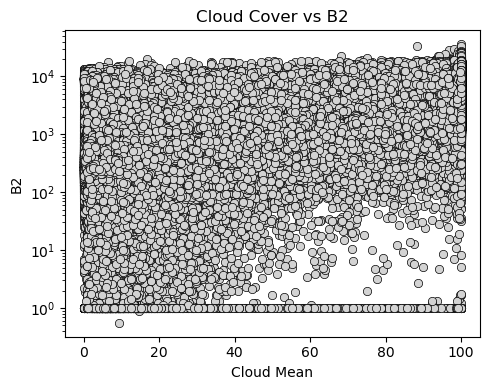

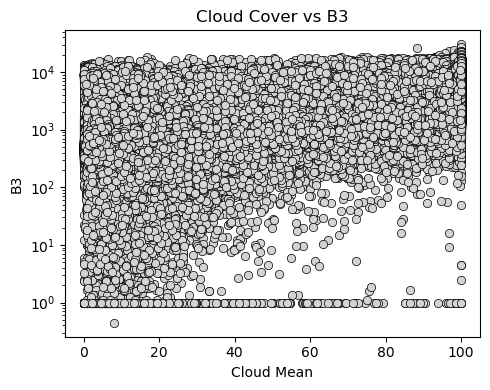

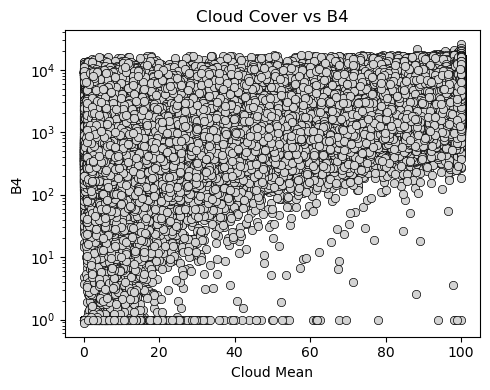

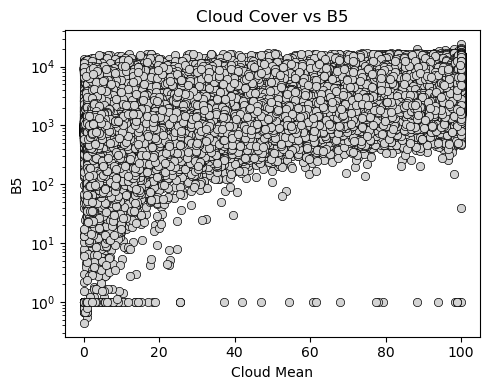

...

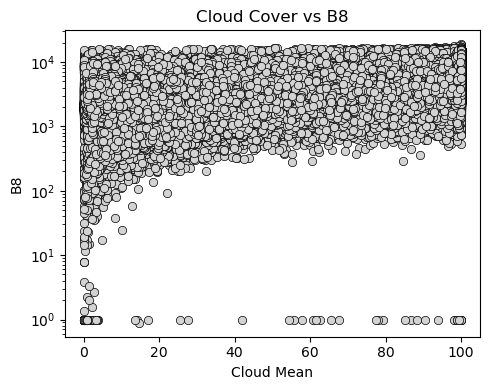

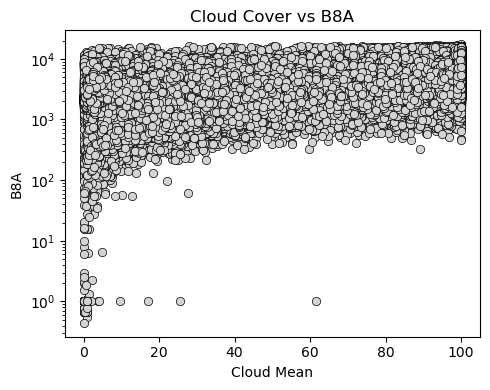

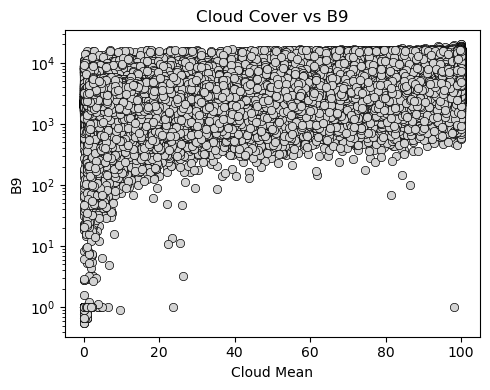

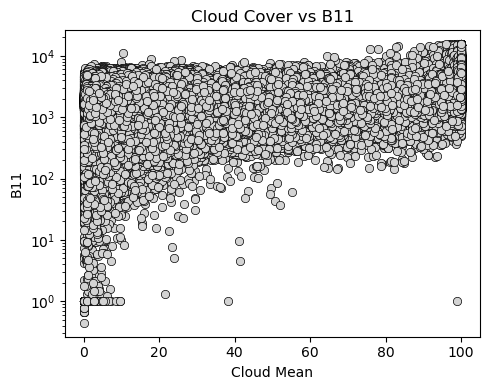

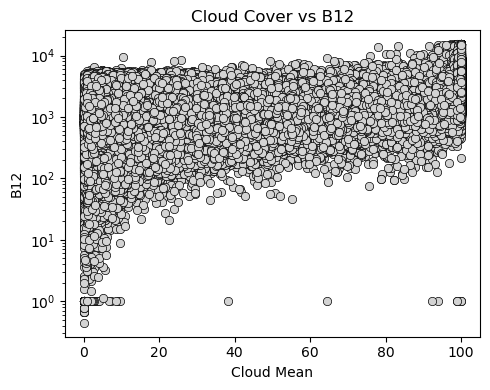

In [31]:
# Band columns
band_cols = ['B1_mean', 'B2_mean', 'B3_mean', 'B4_mean', 'B5_mean', 'B6_mean',
             'B7_mean', 'B8_mean', 'B8A_mean', 'B9_mean', 'B11_mean', 'B12_mean']

# Compute the correlation matrix
df_band_corr = df[['cloud_mean'] + band_cols]
correlations = df_band_corr.corr().loc['cloud_mean', band_cols].sort_values(ascending=False)
print(correlations)

# Plot scatter plots
for band in band_cols:
    plt.figure(figsize=(5,4))
    sns.scatterplot(data=df, x='cloud_mean', y=band,
                    color='lightgrey', edgecolor='black', linewidth=0.5)
    plt.title(f'Cloud Cover vs {band.replace("_mean", "")}')
    plt.xlabel('Cloud Mean')
    plt.yscale('log')
    plt.ylabel(f'{band.replace("_mean", "")}')
    plt.tight_layout()
    plt.savefig(f"../graphs/sentinel/logbands_cloudmean_vs_bands_scatter_{band}.png", dpi=300)
    plt.show()

## Number of Images with 100% Cloud Cover

In [35]:
all_images_cloud = len(df[df['cloud_mean']==100])
print(f"{all_images_cloud} out of {len(df)} images have 100% cloud cover probability.")

381429 out of 1394102 images have 100% cloud cover probability.


In [36]:
unique_point_fullcloud = df[df['cloud_mean']==100]['point_id'].nunique()
print(f"Number of Point IDs with images that have 100% cloud cover: {unique_point_fullcloud}")

Number of Point IDs with images that have 100% cloud cover: 15947


## Point IDs Affected by Cloud Cover

In [37]:
# Set a cloud threshold
cloud_threshold = 0.2

# Find out how many points have at least ony image with cloud within the last 365 days
cloudy_points = df[df['cloud_mean'] > cloud_threshold]['point_id'].nunique()
total_points = df['point_id'].nunique()

print(f"{cloudy_points} out of {total_points} point IDs have at least one cloudy image.")

15954 out of 15954 point IDs have at least one cloudy image.


## Cloudy Images Per Point ID

In [40]:
cloud_threshold = 0.2

cloudy_images_per_point = df[df['cloud_mean'] > cloud_threshold].groupby('point_id').size()

print(cloudy_images_per_point.describe())

count    15954.000000
mean        87.047700
std         34.500644
min          5.000000
25%         55.000000
50%         96.000000
75%        114.000000
max        196.000000
dtype: float64


In [41]:
# Number of images per point
count_df = df.groupby(['point_id']).agg('count').reset_index().rename(columns={'image_date': 'image_count'})[['point_id', 'image_count']]
count_df['image_count'].describe()

count    15954.000000
mean        87.382600
std         34.658885
min          5.000000
25%         55.000000
50%         96.000000
75%        114.000000
max        198.000000
Name: image_count, dtype: float64

## Time Between Images per Point ID

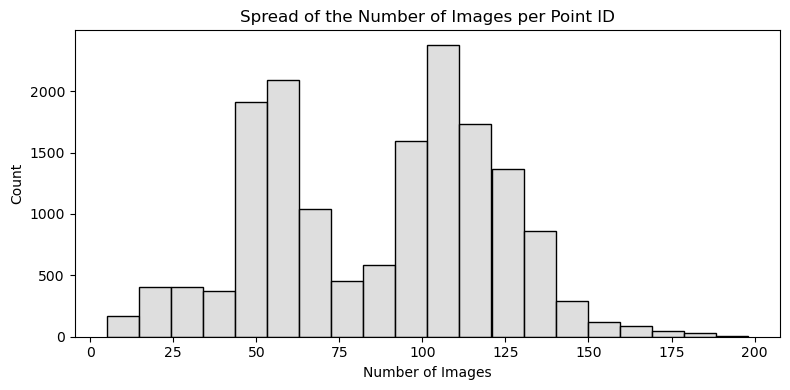

In [53]:
plt.figure(figsize=(8, 4))
sns.histplot(count_df['image_count'], bins=20, color="lightgrey")
plt.xlabel("Number of Images")
plt.title("Spread of the Number of Images per Point ID")
plt.tight_layout()
plt.savefig("../graphs/sentinel/histplot_image_count_per_point.png", dpi=300)
plt.show()

In [54]:
# Sort by more recent images per point, calculate time between each 
df['image_date'] = pd.to_datetime(df['image_date'])
df_sorted = df.sort_values(by=['point_id', 'image_date'])
df_sorted['time_diff'] = df_sorted.groupby('point_id')['image_date'].diff().dt.days

# Average the time between images per point
avg_time_between_images = df_sorted.groupby('point_id')['time_diff'].mean()

print(avg_time_between_images.describe())

count    15954.000000
mean         4.552029
std          1.840906
min          1.704403
25%          3.157895
50%          3.686291
75%          6.206897
max         11.200000
Name: time_diff, dtype: float64


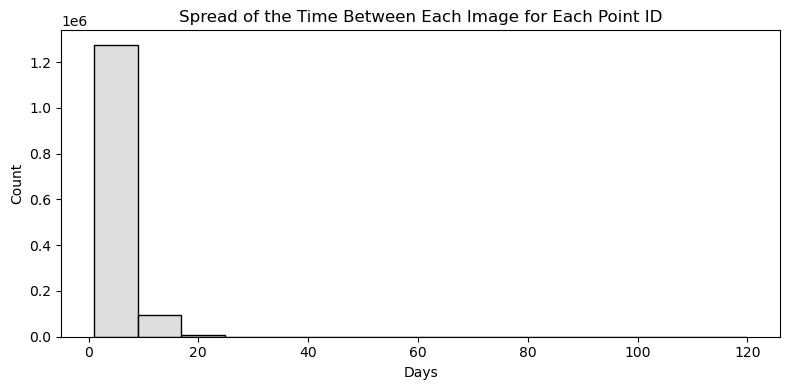

In [55]:
plt.figure(figsize=(8, 4))
sns.histplot(df_sorted['time_diff'], bins=15, color="lightgrey")
plt.xlabel("Days")
plt.title("Spread of the Time Between Each Image for Each Point ID")
plt.tight_layout()
plt.savefig("../graphs/sentinel/histplot_time_between_images.png", dpi=300)
plt.show()

# Select Most Recent Images

### Create Column: days between survey date and satellite image taken

In [47]:
df = mean_df.copy()

In [48]:
# Calculate the days between the footage for sentinel 
df['image_date'] = pd.to_datetime(df['image_date'])
df['survey_date'] = pd.to_datetime(df['survey_date'])

df['days_diff'] = (df['image_date'] - df['survey_date']).dt.days

In [49]:
# Select the closest day
dup_cols = ['point_id', 'survey_date']
closest = df.groupby(dup_cols, as_index=False)['days_diff'].max()
closest = closest.merge(df, how='left', on=['point_id', 'survey_date', 'days_diff'])

In [50]:
print(f"Number of samples: {len(closest)}")
print(f"Number of unique point IDs: {closest['point_id'].nunique()}")

Number of samples: 15954
Number of unique point IDs: 15954


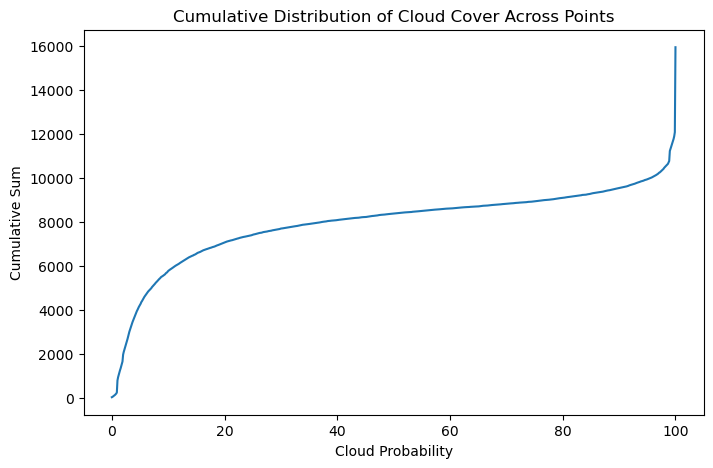

In [51]:
#plot the number of points with each level of cloud cover:
plot_df = closest.groupby('cloud_mean', as_index=False).agg('count')
plot_df['cum_sum'] = plot_df['point_id'].cumsum() 

plt.figure(figsize=(8,5))
sns.lineplot(data=plot_df, x='cloud_mean', y='cum_sum')
plt.title("Cumulative Distribution of Cloud Cover Across Points")
plt.xlabel("Cloud Probability")
plt.ylabel("Cumulative Sum")

plt.show()

## Merge with the Soil DataFrame

In [71]:
merged = closest.merge(soil, how='inner', left_on=['point_id'], right_on=['POINTID'])
len(merged)

15941

### Visualise Cloud Cover by Location

In [72]:
cloud_df = merged.copy()
cloud_df['geometry'] = cloud_df.apply(lambda row: Point(row['gps_long'], row['gps_lat']), axis=1)
gdf = gpd.GeoDataFrame(cloud_df, geometry='geometry', crs='EPSG:4326')

In [73]:
m = folium.Map(location=[gdf['gps_lat'].mean(), gdf['gps_long'].mean()], zoom_start=5)
# Create a color map based on cloud_probability
min_cloud = gdf['cloud_mean'].min()
max_cloud = gdf['cloud_mean'].max()
colormap = cm.LinearColormap(
    colors=cm.linear.RdYlGn_11.colors[::-1],  # reverse color list
    vmin=min_cloud,
    vmax=max_cloud
).to_step(n=10)

# Add points
for _, row in gdf.iterrows():
    color = colormap(row['cloud_mean']) if pd.notnull(row['cloud_mean']) else "#808080"
    folium.CircleMarker(
        location=[row['gps_lat'], row['gps_long']],
        radius=0.5,
        color=color,
        fill=True,
        fill_opacity=0.7,
        popup=f"Cloud: {row['cloud_mean']}%"
    ).add_to(m)

# Add color legend
colormap.caption = "Cloud Probability (%)"
colormap.add_to(m)

m

In [97]:
def view_random_image(
        df,
        cloud_cover: int,
        point_id,
        buffer_radius: int = 600,
        zoom: int = 15
    ):
    
    if point_id is None:
        samples = df[df['cloud_mean'] == cloud_cover]
        sample = samples.sample(random_state=42).iloc[0].to_dict()
    else:
        sample = df[df['point_id'] == point_id].iloc[0].to_dict()
    
    lon, lat = sample['gps_long'], sample['gps_lat']
    img_date = pd.to_datetime(sample['image_date'])
    end = img_date + DateOffset(days=1)

    point = ee.Geometry.Point([lon, lat])
    aoi = point.buffer(buffer_radius).bounds()

    collection = (
        ee.ImageCollection('COPERNICUS/S2_SR_HARMONIZED')
        .filterBounds(aoi)
        .filterDate(img_date.strftime('%Y-%m-%d'), end.strftime('%Y-%m-%d'))
        .distinct('system:time_start')
    )

    image_count = collection.size().getInfo()
    print(f"Point ID: {sample['point_id']}")
    print(f"Images found: {image_count}")
    if image_count == 0:
        raise ValueError("No Sentinel-2 images found for the selected date.")

    # Get first image and extract acquisition date
    image_list = collection.toList(collection.size())
    image = ee.Image(image_list.get(0))
    collected_date = pd.to_datetime(image.get('system:time_start').getInfo(), unit='ms')
    print(f"Image date = {collected_date}")

    # Select RGB bands and clip to AOI
    rgb_image = image.select(['B2', 'B3', 'B4']).clip(aoi)
    vis_params = {'min': 0, 'max': 3000, 'bands': ['B4', 'B3', 'B2']}

    # Create and return map
    m = geemap.Map(center=[lat, lon], zoom=zoom)
    m.addLayer(rgb_image, vis_params, f"Sentinel-2 RGB ({collected_date.strftime('%Y-%m-%d')})")
    return m

In [91]:
ee.Initialize(project='sophies-practice-project-1')

In [92]:
cloud_cover = 20
point_id = 35442124

buffer_radius = 400
zoom = 17

m = view_random_image(gdf, cloud_cover=cloud_cover, point_id=point_id, buffer_radius=buffer_radius, zoom=zoom)
m

Point ID: 35442124
Images found: 1
Image date = 2018-05-06 10:54:23.569000


Map(center=[41.78558, 0.661356], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=Search…

https://developers.google.com/earth-engine/tutorials/community/sentinel-2-s2cloudless

In [98]:
cloud_cover = 20
point_id = None

buffer_radius = 400
zoom = 17

m = view_random_image(gdf, cloud_cover=cloud_cover, point_id=point_id, buffer_radius=buffer_radius, zoom=zoom)
m

Point ID: 31642112
Images found: 1
Image date = 2018-06-13 10:57:37.832000


Map(center=[41.15362, -3.81156], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=Search…

In [100]:
cloud_cover = 100
point_id = None

buffer_radius = 400
zoom = 17

m = view_random_image(gdf, cloud_cover=cloud_cover, point_id=point_id, buffer_radius=buffer_radius, zoom=zoom)
m

Point ID: 44222322
Images found: 1
Image date = 2018-06-18 10:17:33.781000


Map(center=[44.00018, 11.25647], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=Search…

In [101]:
cloud_cover = 0
point_id = None

buffer_radius = 400
zoom = 17

m = view_random_image(gdf, cloud_cover=cloud_cover, point_id=point_id, buffer_radius=buffer_radius, zoom=zoom)
m

Point ID: 49822900
Images found: 1
Image date = 2018-05-13 09:51:26


Map(center=[48.84808, 19.02923], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=Search…